# MICR (Magnetic ink Character Recognition) 

<img src="utils/Cheque-Details.png"/>

> A cheque number is a **6-digit** number uniquely assigned to each cheque leaf. It is written on the left-hand side at the bottom of the cheque.



 > An MICR code is a **9-digit** code that uniquely identifies the bank and branch participating in an Electronic Clearing System (ECS).

It comprises of 3 parts:
- The first three digits represent the city (City Code). They are aligned with the PIN code we use for postal addresses in India.
- The next 3 digits represent the bank (Bank Code)
- The last 3 digits represent the branch (Branch Code)


List of MICR Codes & Bank city codes : https://m.rbi.org.in/Scripts/PublicationsView.aspx?id=1862#A2

Detailed measurement of cheque :  https://rbidocs.rbi.org.in/rdocs/content/PDFs/SCFR220210.pdf

https://www.bot.or.th/English/PaymentSystems/StandardPS/StandardCheque/Documents/E-Std_Cheque-%20as%20of%2017%20Jun%2056.pdf

# Meaning of MICR fonts

Just for Reference...

<img src="utils/font-meaning.png">
<img src="utils/MICR4.png">


**Symbols are mapped as follows in font 2:**

    - Transit symbol:   :
    - On-us symbol:     <
    - Amount symbol:    ;
    - Dash symbol:      =

In [121]:
# Importing necessary libraries
import pytesseract
import cv2
import PIL
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

# set this installation path of pytesseract
pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files\Tesseract-OCR\tesseract.exe'

- Download the MICR font 1 : https://raw.githubusercontent.com/BigPino67/Tesseract-MICR-OCR/master/Tessdata/mcr.traineddata
- **Download the MICR font 2 (Currently using)** : https://github.com/ElMagoElGato/tess_e13b_training

Copy this file in the same path where you kept the tesseract.exe file above : " Program Files\Tesseract-OCR\tessdata\ "

# Custom Function for MICR module

In [152]:
def Cheque_OCR(image_path):
    
    img = Image.open(image_path)
    img = img.resize((2350,1050)) # resizing the input image
    width, height = img.size      # taking the width, height of image
#     display(img)
    
    left = int(width*0.1702) # creating 4 coordinates for cropping bottom part
    top = int(height*0.84)
    right = int(width*0.78)
    bottom = height
    
    draw = ImageDraw.Draw(img)
    draw = draw.rectangle([left, top, right, bottom],fill=None,outline='red', width=5)
    display(img)
    
    
    cropped = img.crop((left, top, right, bottom)) # cropping the bottom part
    cropped = cropped.convert('L')
#     cropped = cropped.point(lambda x:x >100 and 255) # binarizing the image will give poor results
    display(cropped)
    
    
    micr = pytesseract.image_to_string(cropped, lang='e13b')  # applying Pytesseract
    new_micr = (micr.strip().replace("\n", "")).replace(" ", "")
    
    print("RAW FULL TEXT FETCHED : {}".format(new_micr))
    print("CHEQUE NUMBER : {}".format(new_micr[1:7]))
    print("CITY CODE : {}".format(new_micr[8:11]))
    print("BANK CODE : {}".format(new_micr[11:14]))
    print("BRANCH CODE : {}".format(new_micr[14:17]))
    
    return True   

## Type 1

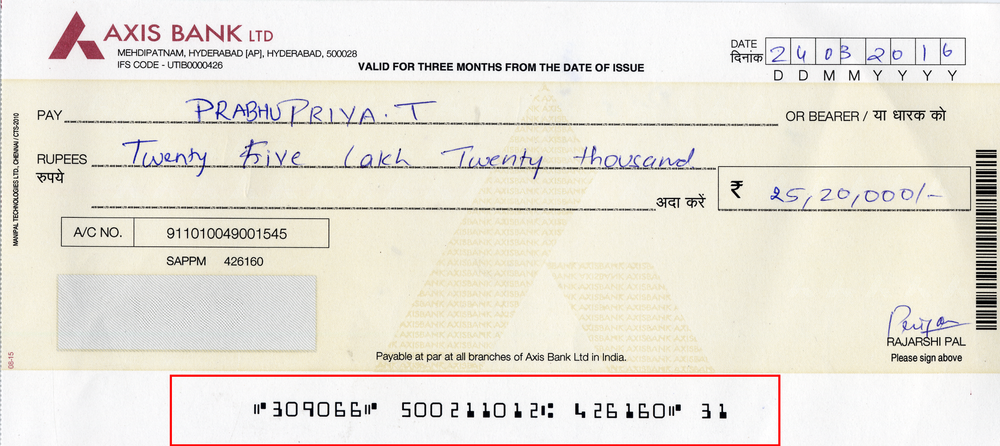

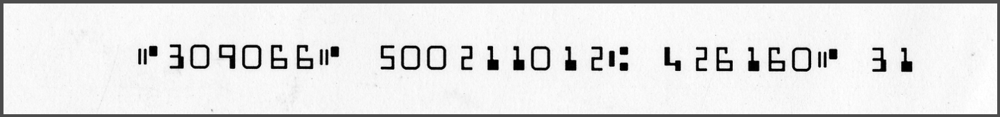

RAW FULL TEXT FETCHED : <309066<500211012:426160<31
CHEQUE NUMBER : 309066
CITY CODE : 500
BANK CODE : 211
BRANCH CODE : 012
Total Time Taken 1.35 seconds


In [153]:
import time
start = time.perf_counter()

Cheque_OCR('Cheque 309066.tif')

end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

# Type 2

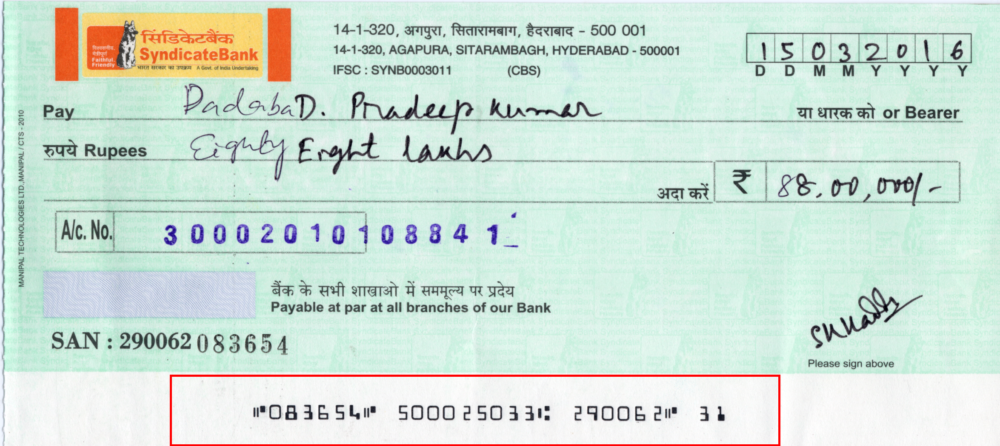

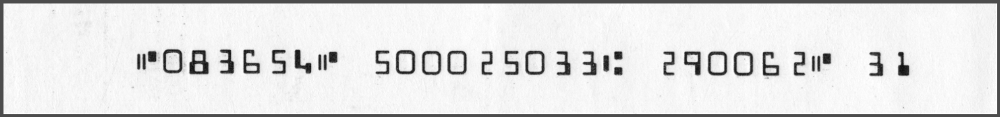

RAW FULL TEXT FETCHED : <083654<500025033:290062<31
CHEQUE NUMBER : 083654
CITY CODE : 500
BANK CODE : 025
BRANCH CODE : 033
Total Time Taken 1.49 seconds


In [154]:
import time
start = time.perf_counter()
Cheque_OCR('Cheque 083654.tif')   
end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

## Type 3

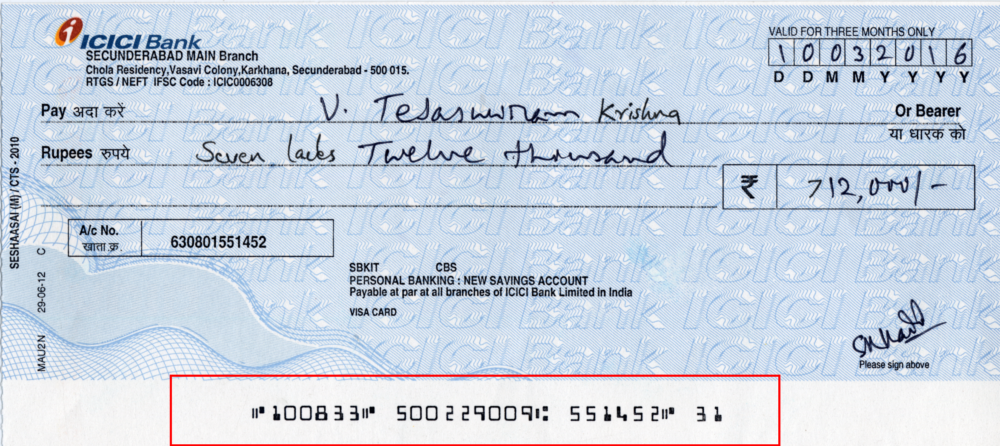

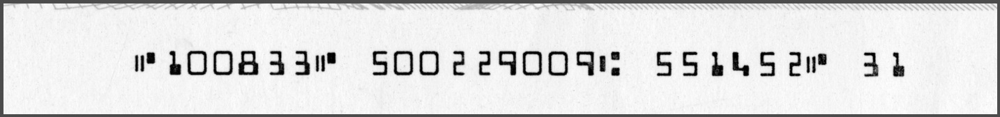

RAW FULL TEXT FETCHED : <100833<500229009:551452<31
CHEQUE NUMBER : 100833
CITY CODE : 500
BANK CODE : 229
BRANCH CODE : 009
Total Time Taken 0.94 seconds


In [143]:
import time
start = time.perf_counter()
Cheque_OCR('Cheque 100833.tif')   
end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

## Type 4

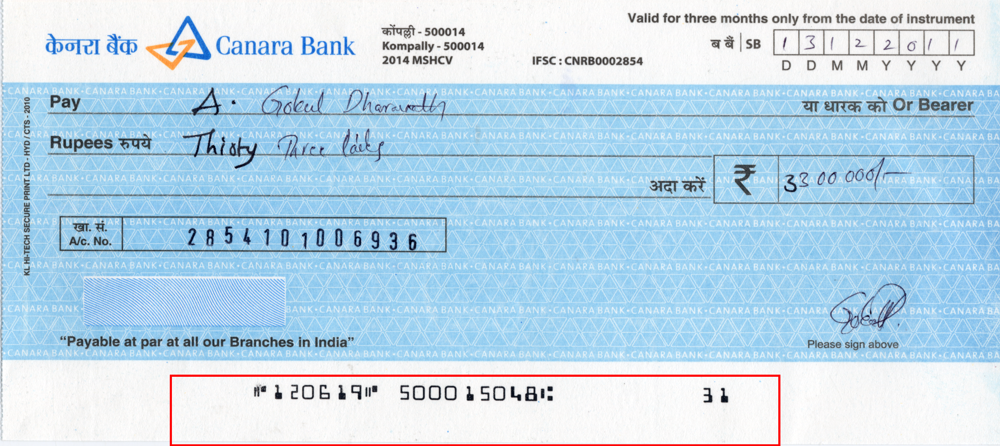

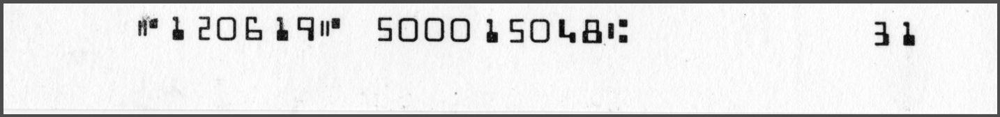

RAW FULL TEXT FETCHED : <120619<500015048:
CHEQUE NUMBER : 120619
CITY CODE : 500
BANK CODE : 015
BRANCH CODE : 048
Total Time Taken 1.25 seconds


In [144]:
import time
start = time.perf_counter()
Cheque_OCR('Cheque 120619.tif')   
end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

# Type 5

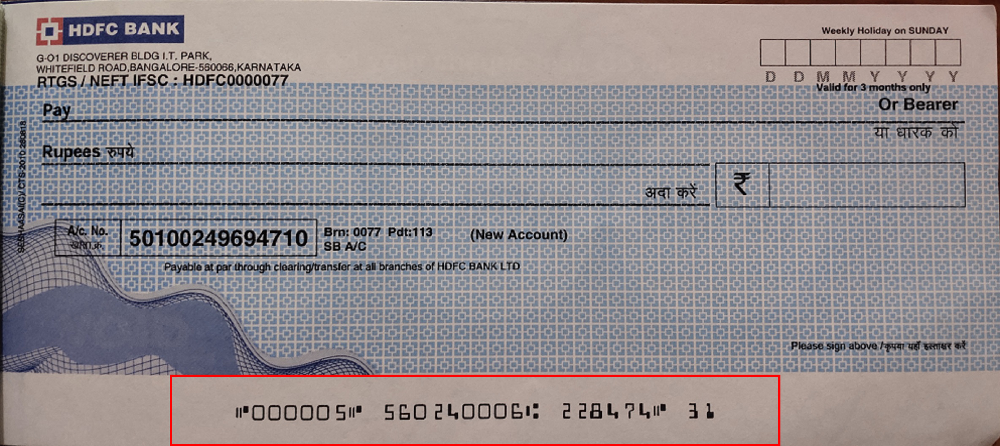

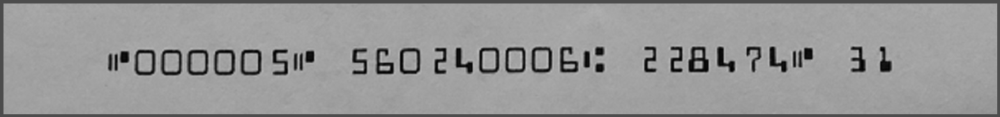

RAW FULL TEXT FETCHED : <000005<560240006:228474<31
CHEQUE NUMBER : 000005
CITY CODE : 560
BANK CODE : 240
BRANCH CODE : 006
Total Time Taken 1.24 seconds


In [145]:
import time
start = time.perf_counter()
Cheque_OCR('hdfc.jpg')   
end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

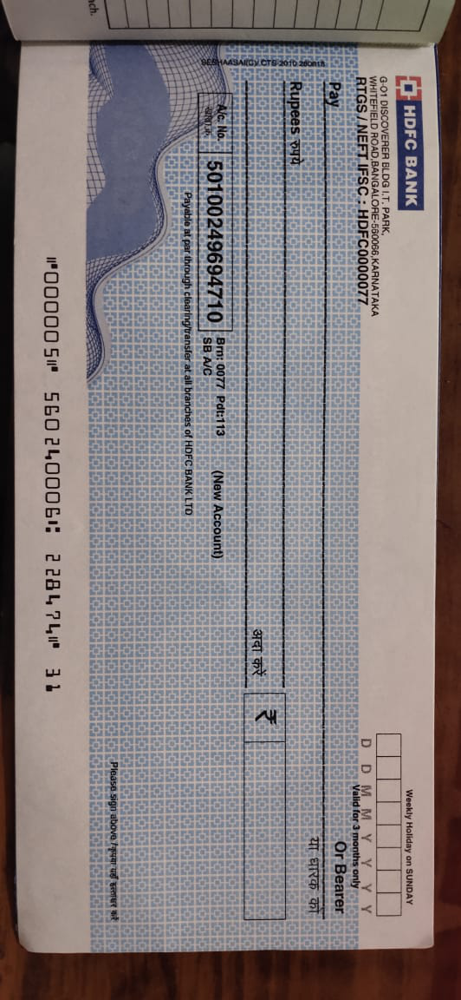

In [155]:
import PIL
from PIL import ImageOps
im = Image.open('cm2.jpg')
im # image is in rotated format!!

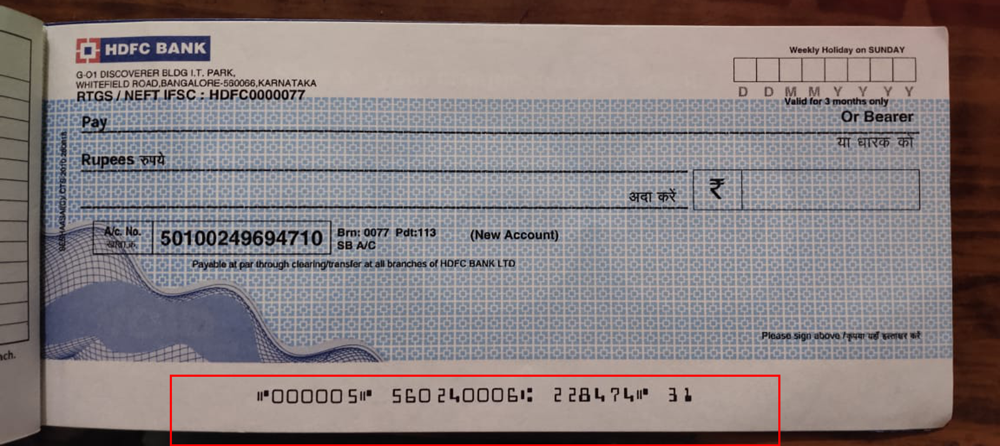

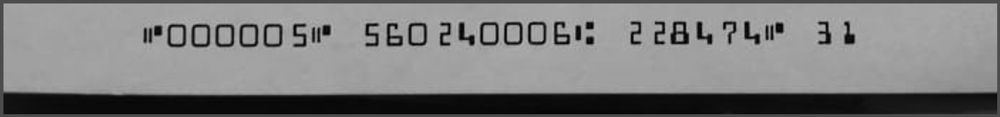

RAW FULL TEXT FETCHED : <000005<560240006:228474<31
CHEQUE NUMBER : 000005
CITY CODE : 560
BANK CODE : 240
BRANCH CODE : 006
Total Time Taken 0.98 seconds


In [157]:
import PIL
from PIL import ImageOps
im = Image.open('cm2.jpg')
im = im.rotate(90,expand=1)
im.save('cm2rotated.png')




import time
start = time.perf_counter()
Cheque_OCR('cm2rotated.png')   
end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

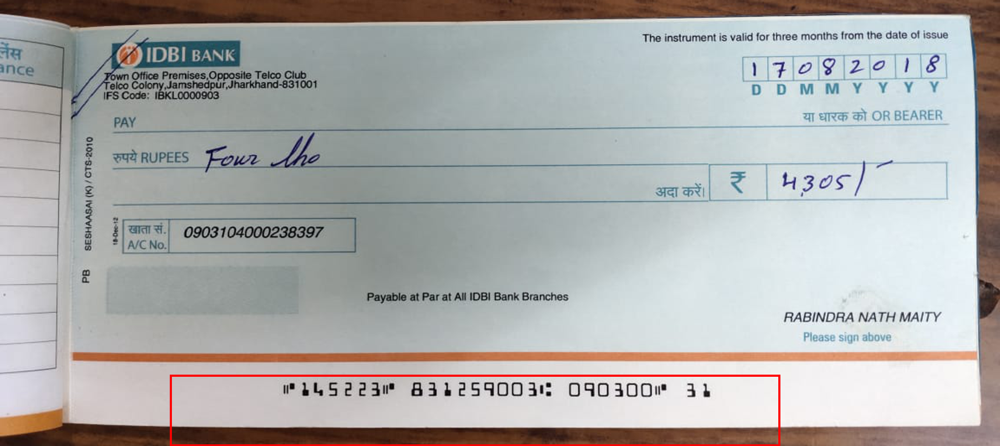

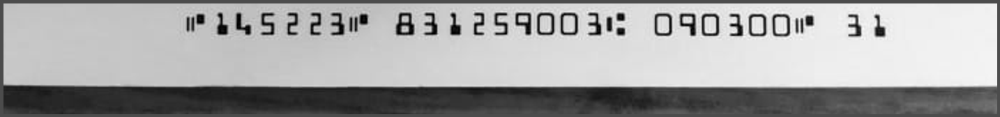

RAW FULL TEXT FETCHED : <145223<831259003:090300<31
CHEQUE NUMBER : 145223
CITY CODE : 831
BANK CODE : 259
BRANCH CODE : 003
Total Time Taken 0.57 seconds


In [150]:
import PIL
from PIL import ImageOps
im = Image.open('idbi2.jpg')
im = im.rotate(90, expand=1)
im.save('idbi2rotated.png')


import time
start = time.perf_counter()
Cheque_OCR('idbi2rotated.png')   
end = time.perf_counter()
print("Total Time Taken {} seconds".format(round(end-start,2)))

# im = im.convert('L')
# im.point(lambda x:x >100 and 255)

# ##############################################################

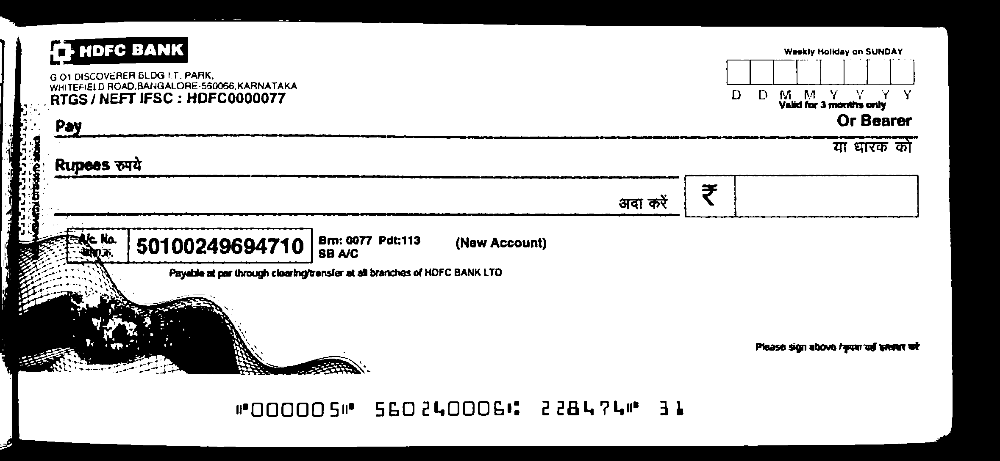

In [23]:
import PIL
from PIL import ImageOps
im = Image.open('cm3.jpg')
im = im.resize((2360,1090))
im = im.convert('L')
im.point(lambda x:x >99 and 255)

In [27]:
image.shape

(532, 1119, 3)

# Localizing the image

In [53]:
import matplotlib.pyplot as plt
%matplotlib inline
import imutils
plt.figure(figsize=(20,16))

image = cv2.imread('cm3.jpg')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
gray = cv2.GaussianBlur(gray, (5,5), 0)
edged = cv2.Canny(gray, 100, 200)

cv2.imshow("edge", edged)
cnts = cv2.findContours(edged.copy(), cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
cnts = sorted(cnts, key =  cv2.contourArea, reverse = True)[:5]

for c in cnts :
    peri = cv2.arcLength(c, True)
    approx = cv2.approxPolyDP(c, 0.02*peri, True)
    
    if len(approx) == 4:
        screenCnt= approx
        break
        
cv2.drawContours(image, [screenCnt], -1, (0,255,0), 2)
cv2.imshow("OUtline", image)
cv2.waitKey(0)
cv2.destroyAllWindows()
# plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

bottom_coordinates = (400, 890, 1850, 1050)

<Figure size 1440x1152 with 0 Axes>

### checking the average width and height of my dataset (just for deciding the resizing parameter!)

In [100]:


import os
path = r'D:\Data Science\ineuron DL Masters\OCR\IDRBT Cheque Image Dataset\300'
width = []
height = []
def check_dimension(path):
    
    files = os.listdir(path)
    for f in files :
        im = Image.open(path+'\\'+f)
        w, h = im.size        
        width.append(w)
        height.append(h)

check_dimension(path)